This notebook uses Iris Dataset to demonstrate logistic regression with two features

An interesting article on Iris dataset:
https://academic.oup.com/jrssig/article/18/6/26/7038520?login=false

- Iris dataset has four features: 

    - sepal length (cm)  
    - sepal width (cm)  
    - petal length (cm)  
    - petal width (cm) 

- It has three classes:
    - Class 0: Iris-setosa
    - Class 1: Iris-versicolor
    - Class 2: Iris-virginica

We construct a new dataset with two features and three classes

- Features    
    - petal width (cm)
    - petal length (cm)

- Classes
    - Class 0: Iris-setosa
    - Class 1: Iris-versicolor
    - Class 2: Iris-virginica


In [56]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from matplotlib.animation import FuncAnimation
from IPython.display import HTML 


np.random.seed(42)

In [57]:
# Load the Iris dataset
iris = datasets.load_iris()
X = iris["data"][:, 2:]  # Petal Length and Petal Width
y = iris["target"]

In [58]:
# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X)

# Add bias term (intercept term) to the feature matrix
X_standardized = np.concatenate((np.ones((X_standardized.shape[0], 1)), X_standardized), axis=1)

In [59]:
# Softmax function
def softmax(z):
    # Subtracting the maximum value in z prevents overflow when computing the exponentials. 
    #This step does not affect the output because it involves scaling the exponentials by a constant factor.
    exp_z = np.exp(z - np.max(z, axis=1, keepdims=True))
    return exp_z / np.sum(exp_z, axis=1, keepdims=True)

# Cross-Entropy Loss
def cross_entropy_loss(y_true, y_pred):
    m = y_true.shape[0]
    log_likelihood = -np.log(y_pred[range(m), y_true])
    return np.sum(log_likelihood) / m

In [60]:
# Initialize parameters
n_samples, n_features = X_standardized.shape
n_classes = len(np.unique(y))
w = np.random.randn(n_features, n_classes)  # Random initialization

# One-Hot Encoding of Labels

One-hot encoding is used to represent categorical variables as binary vectors. 

In the context of multiclass logistic regression, it serves several purposes:
   - Converts categorical labels into a binary format, enabling models to interpret them numerically and caculate the cross-entropy loss.
      - interpret each one-hot encoding vector as a probability distribution
   - Allows numerical iterative optimization such as gradient descent
   - Aligns with the output layer of neural networks or logistic regression models where each class is represented as a separate output node.


## Example

For a dataset with three classes, labels are transformed as follows:
- Class 0: $\begin{bmatrix}1 \\ 0 \\ 0 \\ \end{bmatrix}$
- Class 1: $\begin{bmatrix}0 \\ 1 \\ 0 \\ \end{bmatrix}$
- Class 2:  $\begin{bmatrix}0 \\ 0 \\ 1 \\ \end{bmatrix}$



In [61]:
# One-hot encoding
y_one_hot = np.zeros((n_samples, n_classes))
y_one_hot[np.arange(n_samples), y] = 1


In [62]:
# Mini-Batch Gradient Descent function
def mini_batch_gradient_descent(X, y_one_hot, learning_rate=0.01, n_iterations=300, batch_size=10):
    # n is the number of features
    # m is the number of samples or data instances
    # k is the number of classes or categories for the output
    m, n = X.shape
    _, k = y_one_hot.shape

    # w contains 'k' weight vectors, one for each class
    # each column contains a weight vector corresponding to a class
    w = np.random.randn(n, k)  # Random initialization
    loss_history = []
    frames = []

    for iteration in range(n_iterations):
        shuffled_indices = np.random.permutation(m)
        X_shuffled = X[shuffled_indices]
        y_shuffled = y_one_hot[shuffled_indices]

        for i in range(0, m, batch_size):
            xi = X_shuffled[i:i+batch_size]
            yi = y_shuffled[i:i+batch_size]
            y_pred = softmax(xi.dot(w))
            gradients = (1 / batch_size) * xi.T.dot(y_pred - yi)
            w -= learning_rate * gradients

        y_pred_full = softmax(X.dot(w))
        loss = cross_entropy_loss(y, y_pred_full)
        loss_history.append(loss)
        frames.append((w.copy(), loss_history.copy()))

    return w, loss_history, frames

# Train the model
learning_rate = 0.1
n_iterations = 400
batch_size = int(X.shape[0]) 
final_w, loss_history, frames = mini_batch_gradient_descent(X_standardized, y_one_hot, learning_rate, n_iterations, batch_size)

In [63]:
print(final_w)

[[-0.7335204   1.30833323 -0.96140023]
 [-2.57045853 -0.90925113  0.08347385]
 [-2.96193083 -0.62143219  2.3224917 ]]


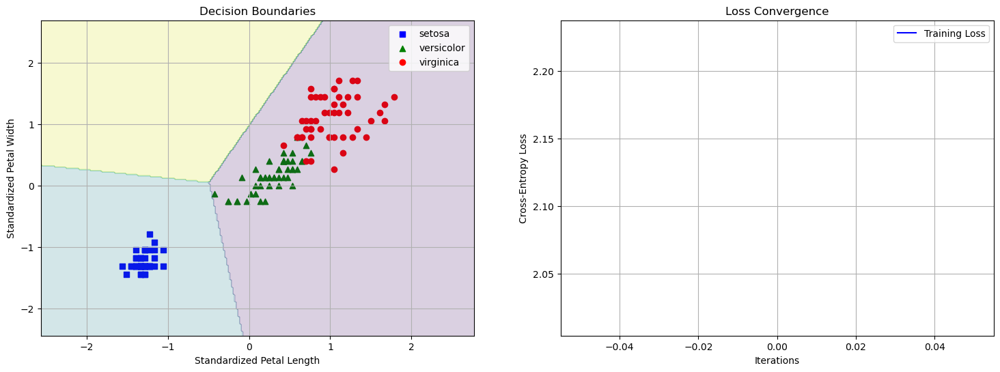

In [64]:
# Setup figure
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

# Animation function
def update(frame_idx):
    w, loss_history = frames[frame_idx]

    # Decision boundary plot
    ax1.clear()
    colors = ['b', 'g', 'r']
    markers = ['s', '^', 'o']
    labels = iris.target_names

    for i in range(n_classes):
        ax1.scatter(X_standardized[y == i][:, 1], X_standardized[y == i][:, 2], c=colors[i], marker=markers[i], label=labels[i])

    x_min, x_max = X_standardized[:, 1].min() - 1, X_standardized[:, 1].max() + 1
    y_min, y_max = X_standardized[:, 2].min() - 1, X_standardized[:, 2].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02), np.arange(y_min, y_max, 0.02))
    Z = softmax(np.c_[np.ones((xx.ravel().shape[0], 1)), xx.ravel(), yy.ravel()].dot(w))
    Z = np.argmax(Z, axis=1).reshape(xx.shape)
    ax1.contourf(xx, yy, Z, alpha=0.2, cmap='viridis')
    ax1.set_xlabel("Standardized Petal Length")
    ax1.set_ylabel("Standardized Petal Width")
    ax1.set_title("Decision Boundaries")
    ax1.legend()
    ax1.grid(True)

    # Loss plot
    ax2.clear()
    ax2.plot(range(frame_idx + 1), loss_history, label='Training Loss', color='blue')
    ax2.set_xlabel('Iterations')
    ax2.set_ylabel('Cross-Entropy Loss')
    ax2.set_title('Loss Convergence')
    ax2.legend()
    ax2.grid(True)

# Create animation
anim = FuncAnimation(
    fig,
    update,
    frames=range(len(frames)),
    repeat=False,
    blit=False,
    cache_frame_data=False
)

# Display the animation in the notebook
HTML(anim.to_jshtml())

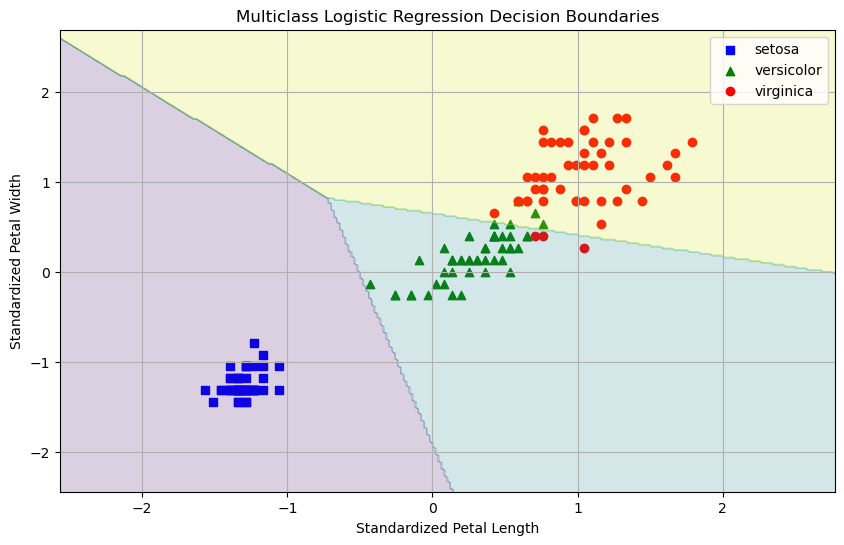

In [65]:
# Load the Iris dataset
iris = datasets.load_iris()
X = iris["data"][:, 2:]  # Petal Length and Petal Width
y = iris["target"]

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X)

# Train logistic regression model for multiclass classification
model = LogisticRegression(multi_class='ovr', solver='lbfgs')
model.fit(X_standardized, y)

# Plotting the decision boundaries
plt.figure(figsize=(10, 6))
colors = ['b', 'g', 'r']
markers = ['s', '^', 'o']
labels = iris.target_names

# Plot each class
for i in range(len(labels)):
    plt.scatter(X_standardized[y == i][:, 0], X_standardized[y == i][:, 1], c=colors[i], marker=markers[i], label=labels[i])

# Plot decision boundaries
x_min, x_max = X_standardized[:, 0].min() - 1, X_standardized[:, 0].max() + 1
y_min, y_max = X_standardized[:, 1].min() - 1, X_standardized[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02), np.arange(y_min, y_max, 0.02))
Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
plt.contourf(xx, yy, Z, alpha=0.2, cmap='viridis')

plt.xlabel("Standardized Petal Length")
plt.ylabel("Standardized Petal Width")
plt.title("Multiclass Logistic Regression Decision Boundaries")
plt.legend()
plt.grid(True)
plt.show()